# Download & Imports

In [36]:
import cv2
import numpy as np
cv2.__version__

import requests
from os import mkdir
from os.path import basename, isdir

def download(url, location='.'):
    response = requests.get(url)
    if response.status_code != 200:
        raise IOError(f"response statis code is {response.status_code}")

    if not isdir(location):
        mkdir(location)

    path = location + '/' + basename(url)
    with open(path, "wb") as file:
        file.write(response.content)

    print(f'The file is successfully downloaded with path: \n{path}')

# загрузка модуля plot_tools:
url = "https://raw.githubusercontent.com/ordevoir/Miscellaneous/master/plot_tools.py"
download(url)

from plot_tools import show_image, show_image_bgr, show_images, show_images_bgr

The file is successfully downloaded with path: 
./plot_tools.py


# Read Image

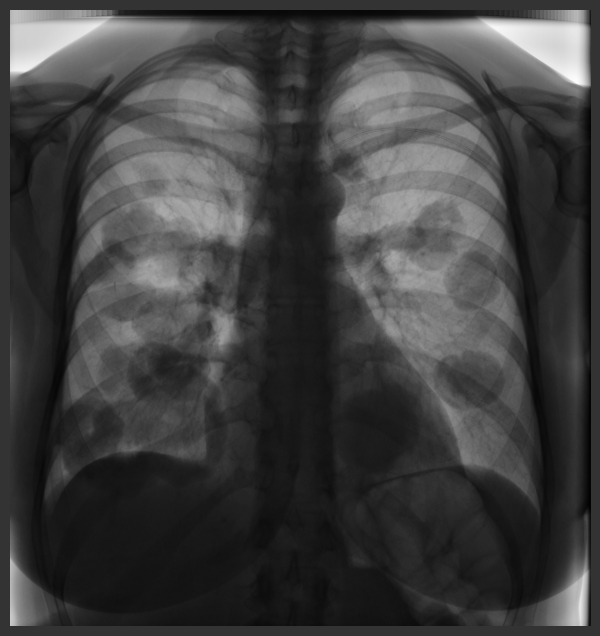

In [37]:
import matplotlib.pyplot as plt
import numpy as np

img = plt.imread("./images/RG1_J2KI.png")
# img = img[..., 0]
show_image(img)

In [38]:
img.dtype, img.shape, img.max()

(dtype('float32'), (1955, 1841), 0.40454718)

In [39]:
img_16bit = (img * (2**16-1)).astype(np.uint16)

In [40]:
LEFT, RIGHT = 500, 1500
TOP, BOTTOM = 500, 1500

def get_fragment(img):
    return img[LEFT:RIGHT, TOP:BOTTOM]
def fragments_of(*images):
    fragments = []
    for img in images:
        fragments.append(get_fragment(img))
    return fragments

# Blur

## [Median Filter](https://docs.opencv.org/4.x/d4/d86/group__imgproc__filter.html#ga564869aa33e58769b4469101aac458f9)

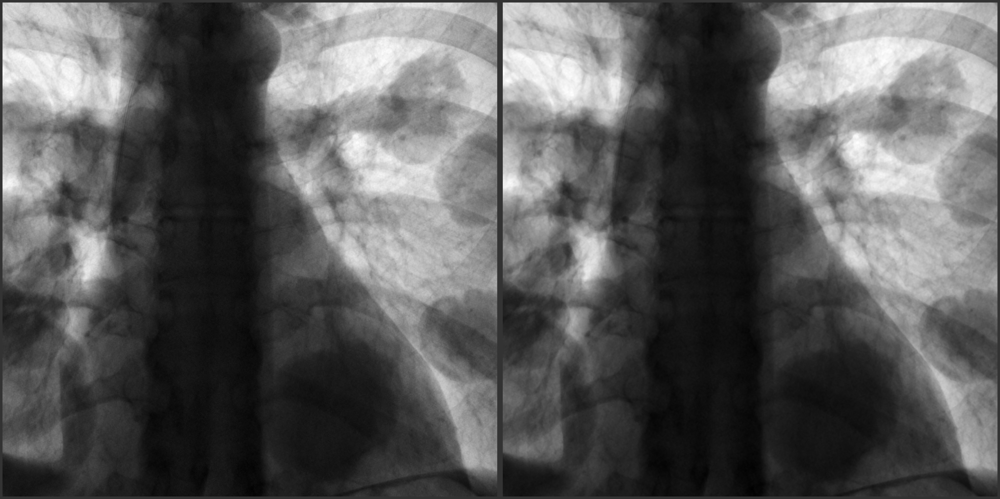

dtype('uint16')

In [41]:
# median_blured = cv2.medianBlur(img, ksize=5)
# show_images(fragments_of(img, median_blured), size=20)

median_blured = cv2.medianBlur(img_16bit, ksize=3)
show_images(fragments_of(img_16bit, median_blured), size=20)

median_blured.dtype

## [Bilateral Filter](https://docs.opencv.org/4.x/d4/d86/group__imgproc__filter.html#ga9d7064d478c95d60003cf839430737ed)

Функция `cv2.bilateralFilter()` применима только к 8U или 32F форматам. 

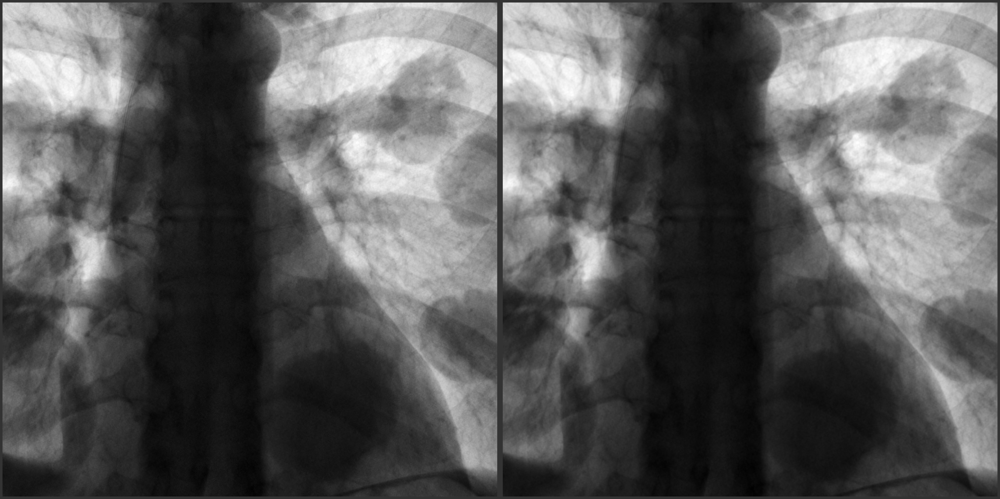

In [42]:
bilateral = cv2.bilateralFilter(img, d=3, sigmaColor=0.3, sigmaSpace=10)
show_images(fragments_of(img, bilateral), size=20)

## [Gaussian Filter](https://docs.opencv.org/4.x/d4/d86/group__imgproc__filter.html#gaabe8c836e97159a9193fb0b11ac52cf1)

Гауссовый фильр характеризуется тем, что значения элементов ядра меняются от центра к краю по нормальному распределению. Пример ядра $3 \times 3$, $σ≈1$:

$$
\frac{1}{16} 
\begin{bmatrix} 
1 & 2 & 1 \\ 
2 & 4 & 2 \\ 
1 & 2 & 1 \\ 
\end{bmatrix}
$$

Параметры `sigmaX` и `sigmaY` характеризуют среднеквадратическое отклонение значений ядра фильтра вдоль X и вдоль Y соответственно. Если `sigmaY` не задано (или задано равным 0), то значение `sigmaY` будет равно значению `sigmaX`.

In [58]:
gaussian = cv2.GaussianBlur(img, ksize=(5, 5), sigmaX=.8)

# show_images(fragments_of(gaussian1, gaussian2), size=20)

## [Box Filter](https://docs.opencv.org/4.x/d4/d86/group__imgproc__filter.html#gad533230ebf2d42509547d514f7d3fbc3)

Принцип размытия `boxFilter()` аналогичен принципу, по которому производится размытие функцией [`blur()`](https://docs.opencv.org/4.x/d4/d86/group__imgproc__filter.html#ga8c45db9afe636703801b0b2e440fce37). Допустимые форматы: `CV_8U`, `CV_16U`, `CV_16S`, `CV_32F` или `CV_64F`. Но в отличие от `blur()`, функция `boxFilter()` позволяет использовать ненормальизованные ядра (если задать параметра `normalize=False`), что может быть полезным при вычислении различных интегральных характеристик по соседним пикселям, такие как матрицы ковариаций производных изображения.

$$
\frac{1}{9}
\begin{bmatrix} 
1 & 1 & 1 \\ 
1 & 1 & 1 \\ 
1 & 1 & 1 \\ 
\end{bmatrix}
$$

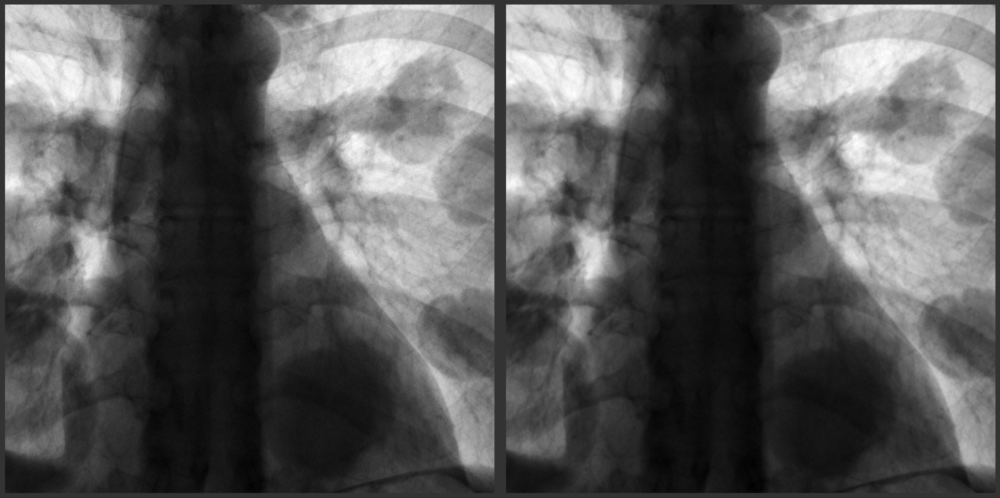

In [59]:
box_blured = cv2.boxFilter(img, ddepth=-1, ksize=(3, 3), anchor=(1, 1))
show_images(fragments_of(img, box_blured), size=10)

## Comparison

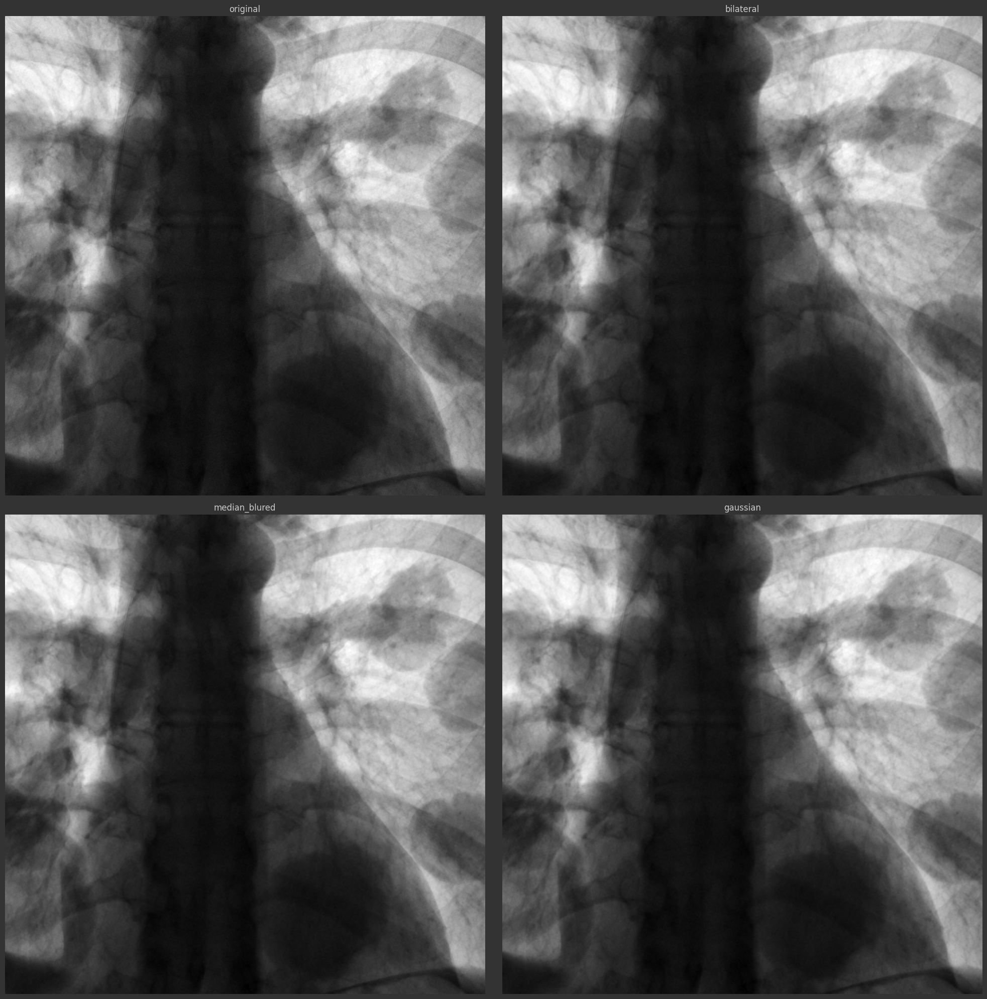

In [60]:
images = fragments_of(img, bilateral, median_blured, gaussian)
show_images(images, ["original", "bilateral", "median_blured", "gaussian"], size=10)

# [Denoising](https://docs.opencv.org/4.x/d1/d79/group__photo__denoise.html)

Три основных типа шума:
1. Gaussian Noise: случайныйы шум с гауссовым распределением.
1. Impulse Noise: хаотические всплески (salt) и провалы (pepper) в значениях пикселей.
1. Speckle Noise: зернистость.

Для подавления гауссового шума лучше подходят Gaussian Filter и алгоритм [Non-local Means Denoising](https://www.ipol.im/pub/art/2011/bcm_nlm/). Поледний используется ниже в функции [`fastNlMeansDenoising()`](https://docs.opencv.org/3.4/d1/d79/group__photo__denoise.html#ga76abf348c234cecd0faf3c42ef3dc715). 

С подавлением salt и pepper хорошо сравляется Median Filter, в силу своей робастности.

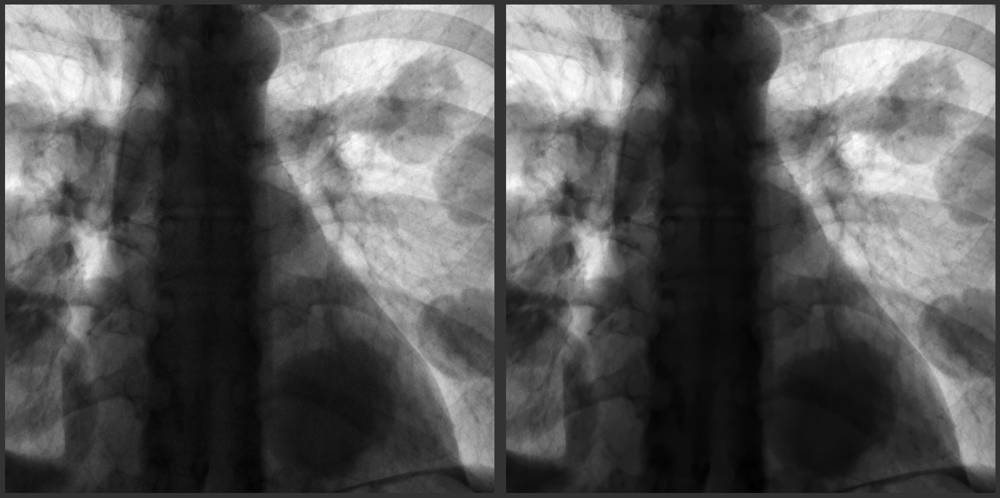

In [46]:
denoised = cv2.fastNlMeansDenoising(img_16bit, h=[100], 
                                    templateWindowSize=7, 
                                    searchWindowSize=21, 
                                    normType=cv2.NORM_L1)

show_images(fragments_of(img_16bit, denoised), size=10)

## Sharpening

Рассмотрим два ядра для увеличения резкости:

In [47]:
sharp_kernel_1 = np.full((3, 3), -1)
sharp_kernel_1[1, 1] = 9
sharp_kernel_1

array([[-1, -1, -1],
       [-1,  9, -1],
       [-1, -1, -1]])

In [48]:
sharp_kernel_2 = np.ones((3, 3))
sharp_kernel_2[1, 1] = -7
sharp_kernel_2

array([[ 1.,  1.,  1.],
       [ 1., -7.,  1.],
       [ 1.,  1.,  1.]])

Заметим, что сумма элементов в обеих матрица равна нулю, и потому, ядра не нуждаются в нормализации. Первое ядро будет давать высокую сумму свертки для ярких пикселей, которые окружены тусклыми пикселями, а второе ядро, наоборот, для тусклого пикселя, окруженного яркими. Эти ядра, конечно, будут дава гипертрофированный результат.

Можно игнорировать диагональные пиксели. Такое ядро даст более мягкое усление резкости.

In [49]:
sharp_kernel_3 = np.array([[ 0, -1,  0],
                           [-1,  5, -1],
                           [ 0, -1,  0]])

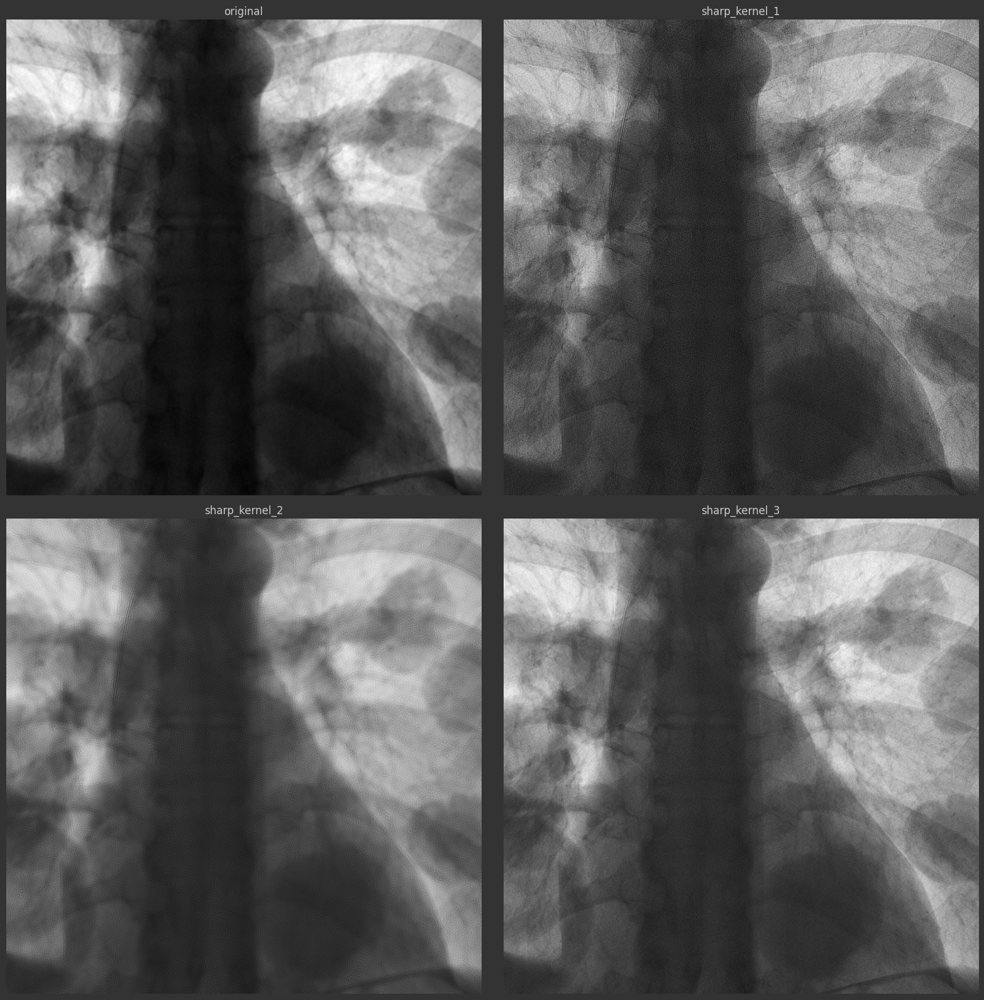

In [50]:
sharped_img_1 = cv2.filter2D(img_16bit, -1, sharp_kernel_1)
sharped_img_2 = cv2.filter2D(img_16bit, -1, sharp_kernel_2)
sharped_img_3 = cv2.filter2D(img_16bit, -1, sharp_kernel_3)

show_images(fragments_of(img_16bit, sharped_img_1, sharped_img_2, sharped_img_3),
         ("original", "sharp_kernel_1", "sharp_kernel_2", "sharp_kernel_3"),
         size=8)

Для регулирования силы увеличения резкости, можно создавать менее контрастные ядра:

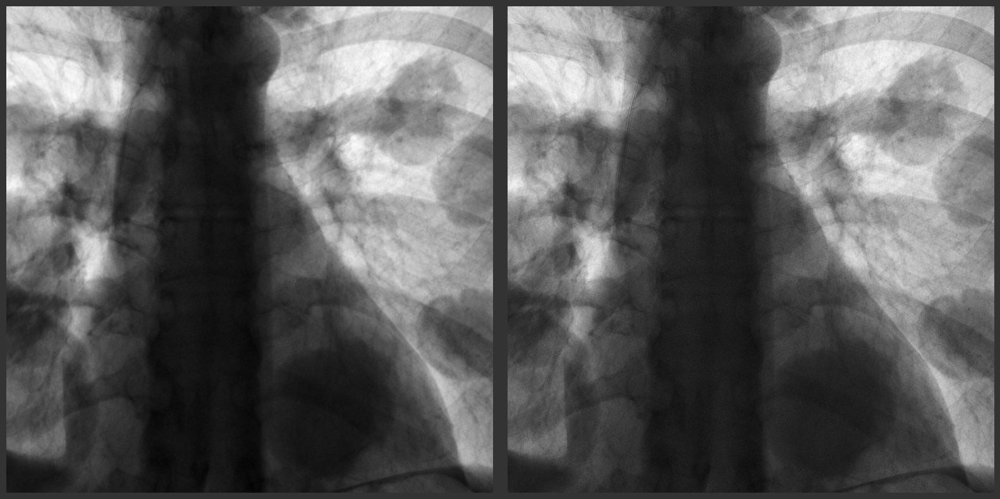

In [51]:
def get_kernel(strength=1.0):
    assert strength <= 1. or strength > 0, ("asdf" )
    kernel = np.full((3, 3), fill_value=-strength, dtype=float)
    kernel[1, 1] = 8 * strength + 1
    return kernel

sharped_img_4 = cv2.filter2D(img_16bit, -1, get_kernel(0.2))
show_images(fragments_of(img_16bit, sharped_img_4), size=8)

Для того, чтобы увеличить резкость, можно добавить в исходное изображение разность между сглаженной и оригинальной картинкой (детали).

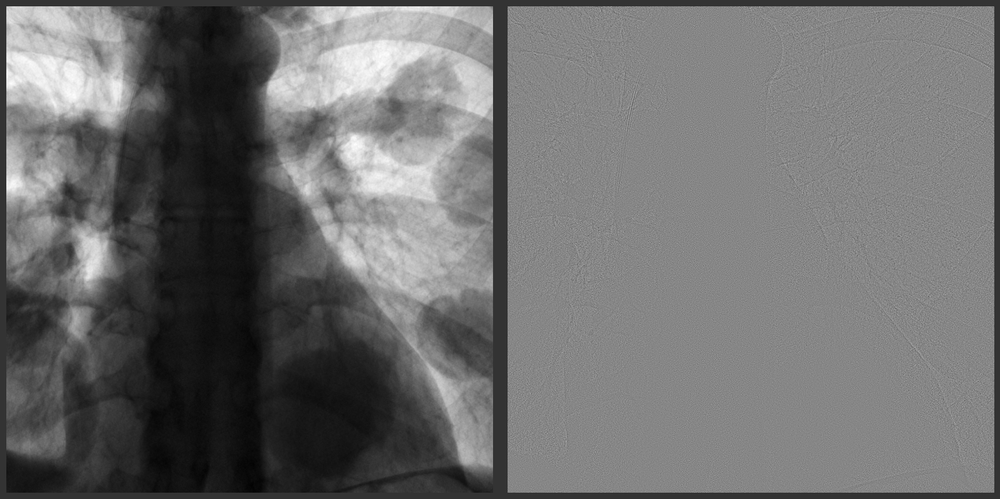

In [52]:
difference = img - bilateral
difference -= difference.min()
difference /= difference.max()
difference.min(), difference.max()

show_images(fragments_of(img, difference), size=8)

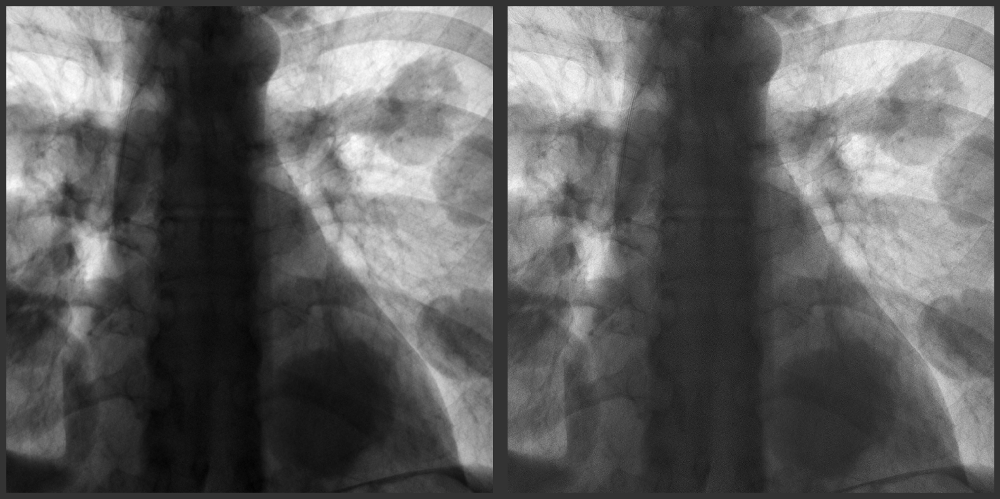

In [53]:
strenght = 0.3
sharpened = img * (1-strenght) + difference * strenght
show_images(fragments_of(img, sharpened), size=8)

# Резкость и сглаживание

Произведем увеличение резкости сглаженного изображения `gaussian`.

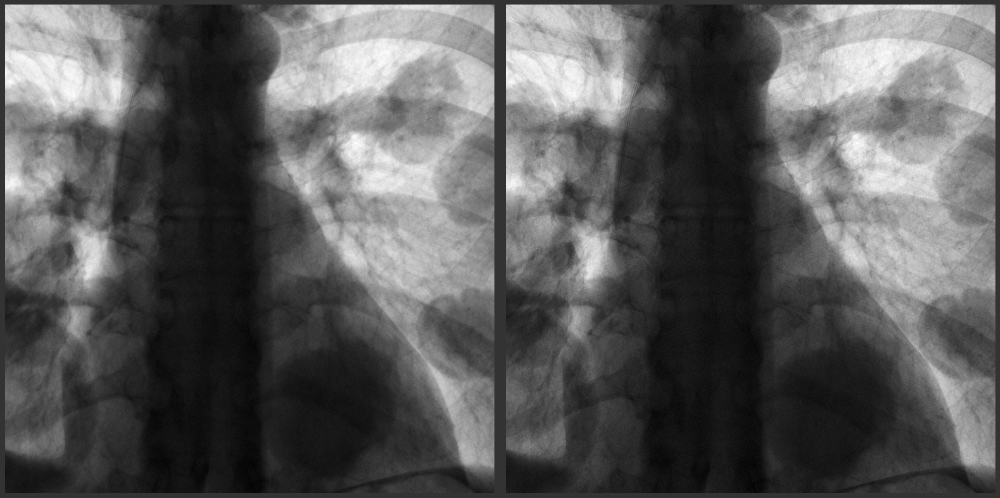

In [61]:
sharp_blured = cv2.filter2D(gaussian, -1, sharp_kernel_3)
show_images(fragments_of(img, sharp_blured), size=10)

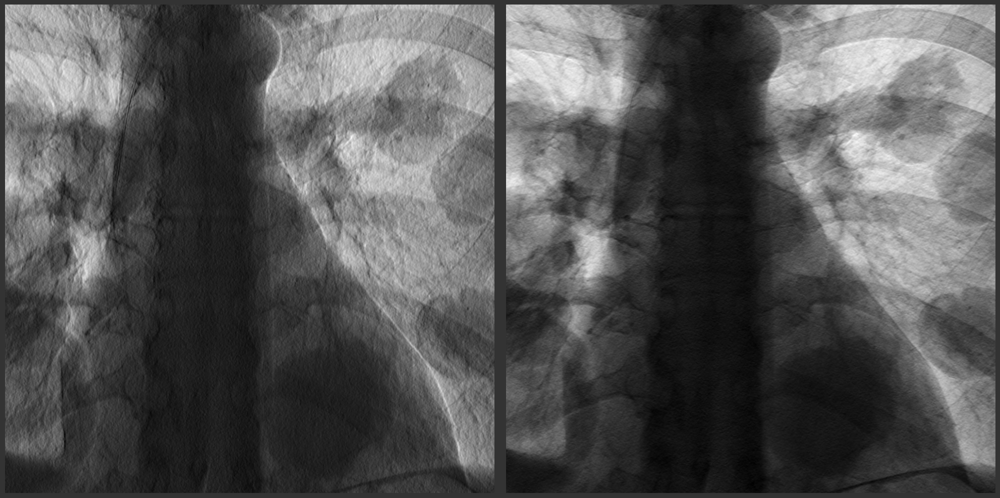

In [62]:
kernelX = np.array([[-1, 0, 1],
                    [-2, 1, 2],
                    [-1, 0, 1]])

kernelY = np.array([[-1, -2, -1],
                    [ 0,  1,  0],
                    [ 1,  2,  2]])

sharp_X = cv2.filter2D(gaussian, -1, kernelX)
sharp_Y = cv2.filter2D(gaussian, -1, kernelY)

show_images(fragments_of(sharp_X, sharp_Y), size=10)

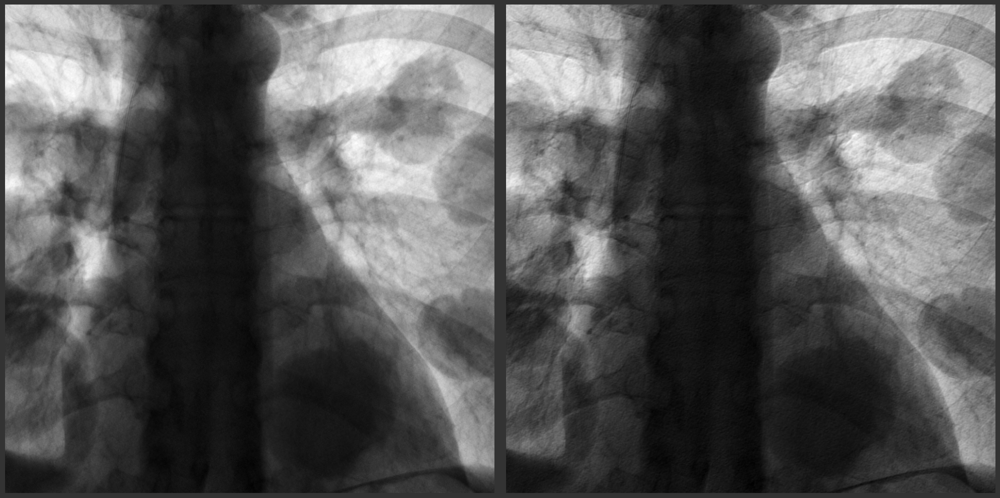

In [63]:
sharp = np.sqrt(sharp_X.astype(np.float64) ** 2 + sharp_Y.astype(np.float64) ** 2)
show_images(fragments_of(img, sharp), size=10)

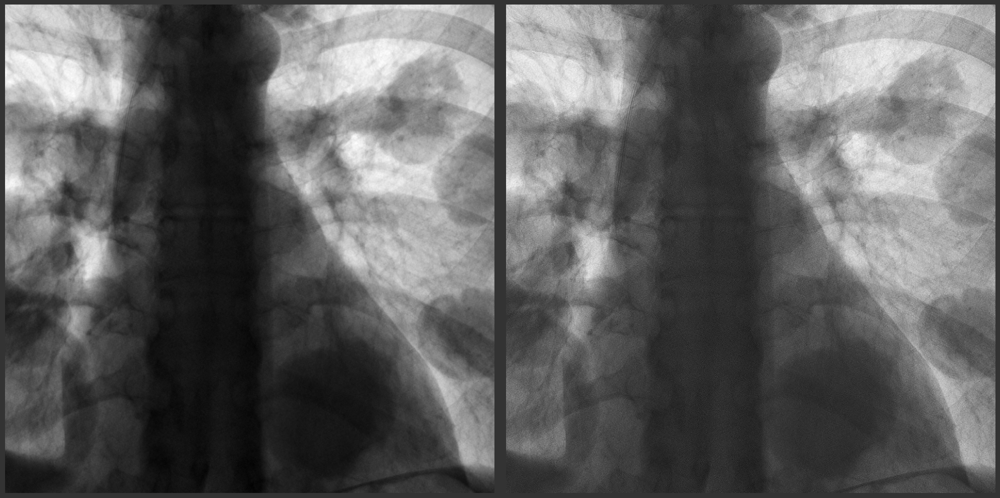

In [64]:
show_images(fragments_of(img, sharped_img_3*0.5 + sharp*0.5), size=10)

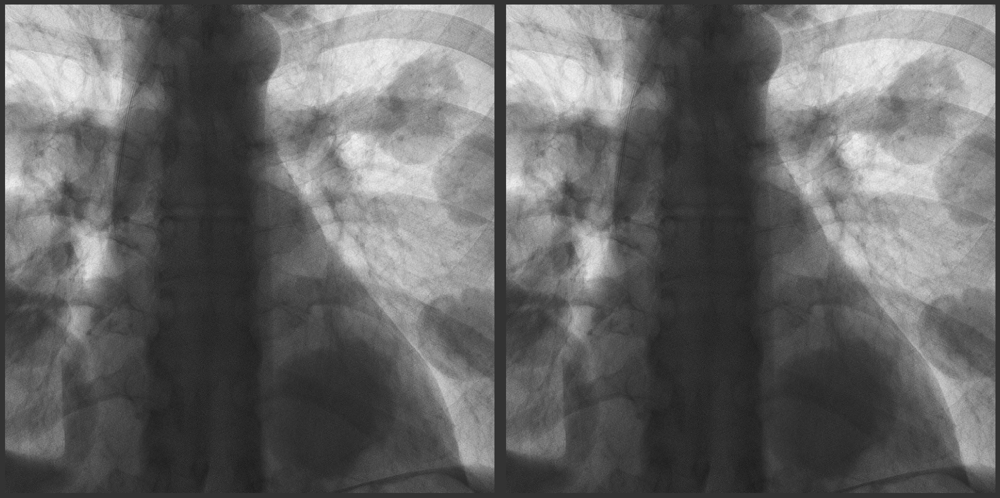

In [65]:
strength = 3
kernelX = np.array([[-0, 0, 0],
                    [-strength, 1, strength],
                    [-0, 0, 0]])

kernelY = np.array([[-0, -strength, -0],
                    [ 0,  1,  0],
                    [ 0,  strength,  0]])

sharp_X = cv2.filter2D(img, -1, kernelX)
sharp_Y = cv2.filter2D(img, -1, kernelY)
sharp = np.sqrt(sharp_X.astype(np.float64) ** 2 + sharp_Y.astype(np.float64) ** 2)

show_images(fragments_of(sharped_img_3, sharped_img_3*0.5 + sharp*0.5), size=10)